In [1]:
import torch
import numpy as np
import cv2
import matplotlib.pyplot as plt
from segment_anything import sam_model_registry, SamAutomaticMaskGenerator
import clip
from PIL import Image

In [3]:
sam_checkpoint = "checkpoints/sam_vit_b_01ec64.pth"  # Download from Meta's repo if not available
sam = sam_model_registry["vit_b"](checkpoint=sam_checkpoint).to("cuda")

mask_generator = SamAutomaticMaskGenerator(sam)

In [4]:
device = "cuda" if torch.cuda.is_available() else "cpu"
clip_model, preprocess = clip.load("ViT-B/32", device=device)

In [5]:
def segementation(image_path):
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert to RGB
    masks = mask_generator.generate(image)

# Display the image
    plt.figure(figsize=(10, 10))
    plt.imshow(image)
    plt.axis("off")
    plt.show()

# Display the first few segmentation masks
    for i, mask in enumerate(masks[:5]):  # Display first 5 masks
        plt.figure(figsize=(5, 5))
        plt.imshow(mask["segmentation"], cmap="jet", alpha=0.5)
        plt.axis("off")
        plt.title(f"Segment {i+1}")
        plt.show()

    return image, masks

In [6]:
def extract_segment_embeddings(image, masks):
    """
    Extracts CLIP embeddings for each segmented region.
    """
    image_pil = Image.fromarray(image)
    segment_embeddings = []
    
    for mask_data in masks:
        mask = mask_data["segmentation"]
        masked_image = np.zeros_like(image)
        masked_image[mask] = image[mask]

        # Convert to PIL Image
        pil_segment = Image.fromarray(masked_image)
        processed_segment = preprocess(pil_segment).unsqueeze(0).to(device)

        # Get CLIP embedding
        with torch.no_grad():
            image_features = clip_model.encode_image(processed_segment)
        image_features /= image_features.norm(dim=-1, keepdim=True)  # Normalize
        
        segment_embeddings.append(image_features)
    
    return segment_embeddings

def extract_segment_embeddings2(image, masks):
    segment_embeddings = []

    for i, mask in enumerate(masks):
        # Find bounding box of the mask
        y_indices, x_indices = np.where(mask)
        if len(y_indices) == 0 or len(x_indices) == 0:
            continue  # Skip empty masks
        
        x_min, x_max = x_indices.min(), x_indices.max()
        y_min, y_max = y_indices.min(), y_indices.max()
        
        # Crop segment
        cropped_segment = image[y_min:y_max, x_min:x_max]

        # Convert to PIL Image and preprocess for CLIP
        pil_segment = Image.fromarray(cropped_segment)
        processed_segment = preprocess(pil_segment).unsqueeze(0).to(device)

        # Get CLIP embedding
        with torch.no_grad():
            image_features = clip_model.encode_image(processed_segment)
        image_features /= image_features.norm(dim=-1, keepdim=True)  # Normalize
        
        segment_embeddings.append(image_features)
    
    return segment_embeddings


In [7]:
def match_segments_to_text(segment_embeddings, text_embeddings, category_prompts):
    """
    Matches each segment to the most similar text category.
    """
    matched_results = []
    
    for i, segment_embedding in enumerate(segment_embeddings):
        similarities = (segment_embedding @ text_embeddings.T).squeeze(0)  # Compute dot product
        max_index = similarities.argmax().item()  # Find the best match
        best_category = category_prompts[max_index]
        best_score = similarities[max_index].item()

        matched_results.append((i, best_category, best_score))
        print(f"Segment {i+1}: Best match -> {best_category} with score {best_score:.4f}")

    return matched_results


In [8]:
def overlay_mask(image, masks, matched_segments):
    overlay = image.copy()
    
    for segment_idx, category, score in matched_segments:
        mask = masks[segment_idx]["segmentation"]
        color = np.random.randint(0, 255, (1, 3), dtype=np.uint8)  # Random color
        overlay[mask] = (overlay[mask] * 0.5 + color * 0.5).astype(np.uint8)

        # Annotate with text
        y, x = np.where(mask)
        if len(y) > 0 and len(x) > 0:
            min_x, min_y = x.min(), y.min()
            cv2.putText(overlay, category, (min_x, min_y - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 2)

    return overlay


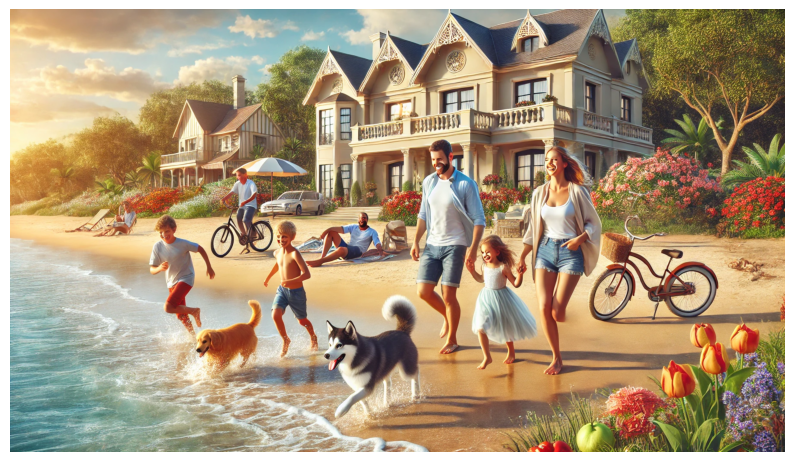

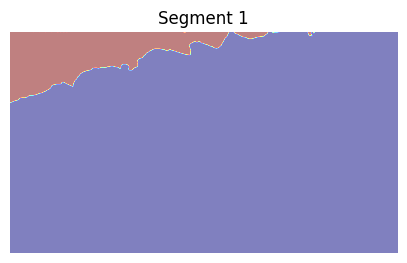

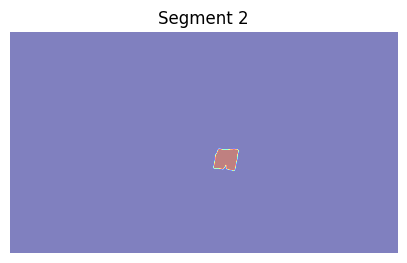

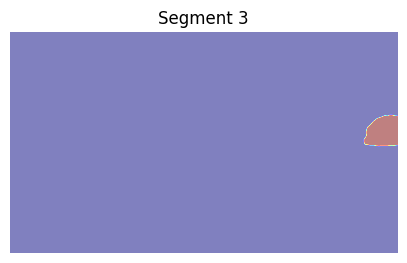

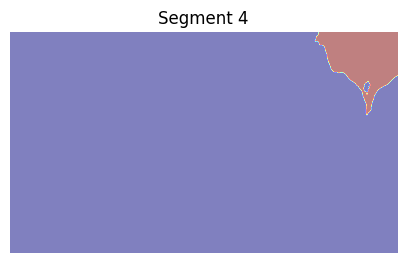

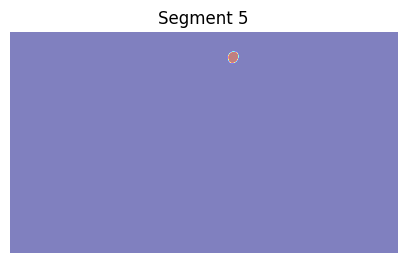

Segment 1: Best match -> house with score 0.2369
Segment 2: Best match -> person with score 0.2295
Segment 3: Best match -> person with score 0.2566
Segment 4: Best match -> person with score 0.2563
Segment 5: Best match -> person with score 0.2189
Segment 6: Best match -> person with score 0.2218
Segment 7: Best match -> person with score 0.2247
Segment 8: Best match -> dog with score 0.2218
Segment 9: Best match -> person with score 0.2460
Segment 10: Best match -> person with score 0.2566
Segment 11: Best match -> person with score 0.2465
Segment 12: Best match -> dog with score 0.2800
Segment 13: Best match -> person with score 0.2512
Segment 14: Best match -> tree with score 0.2454
Segment 15: Best match -> person with score 0.2078
Segment 16: Best match -> person with score 0.2527
Segment 17: Best match -> person with score 0.2427
Segment 18: Best match -> dog with score 0.2441
Segment 19: Best match -> car with score 0.2460
Segment 20: Best match -> person with score 0.2512
Segm

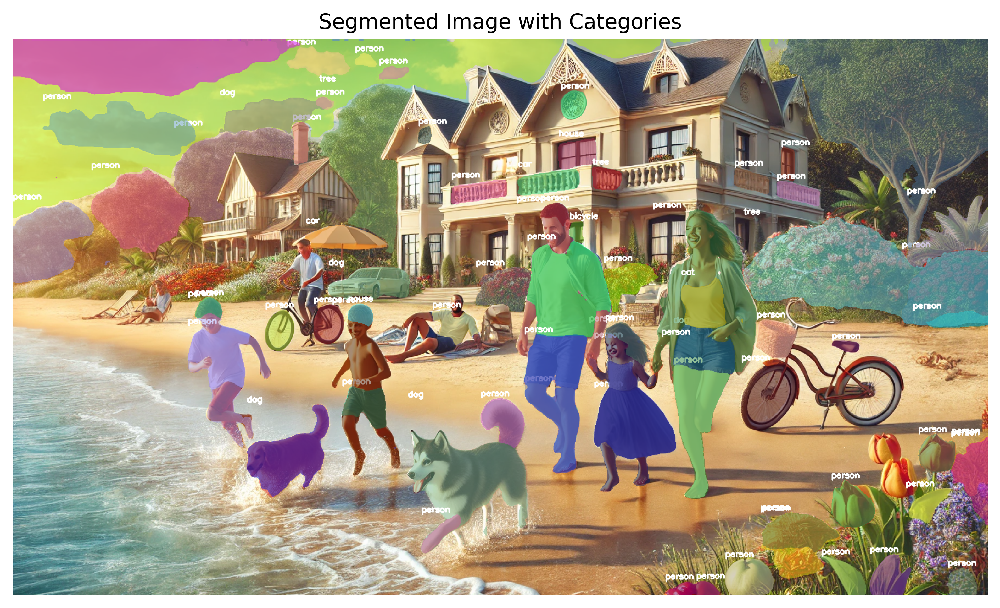

In [9]:
image1, masks1 = segementation("./images/family.png")
segment_embeddings1 = extract_segment_embeddings(image1, masks1)
category1 = ["dog", "cat", "tree", "car", "person","house","flowers","bicycle"]

with torch.no_grad():
    text_inputs = clip.tokenize(category1).to(device)
    text_embeddings1 = clip_model.encode_text(text_inputs)
    text_embeddings1 /= text_embeddings1.norm(dim=-1, keepdim=True) 

matched_segments1 = match_segments_to_text(segment_embeddings1, text_embeddings1, category1)
overlayed_image = overlay_mask(image1, masks1, matched_segments1)

plt.figure(figsize=(10, 10),dpi=400)
plt.imshow(overlayed_image)
plt.axis("off")
plt.title("Segmented Image with Categories")
plt.show()

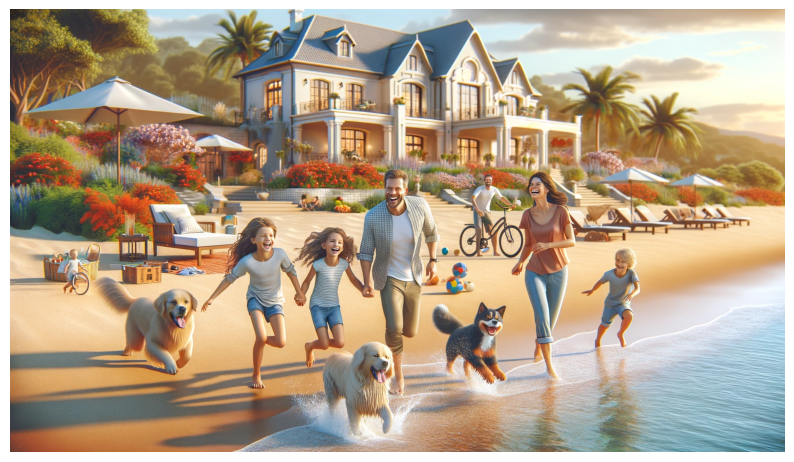

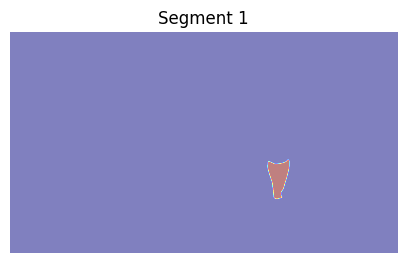

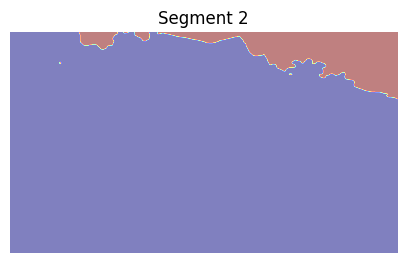

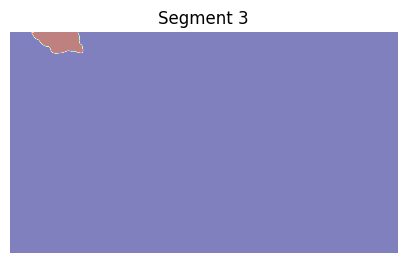

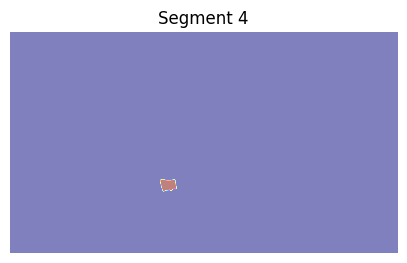

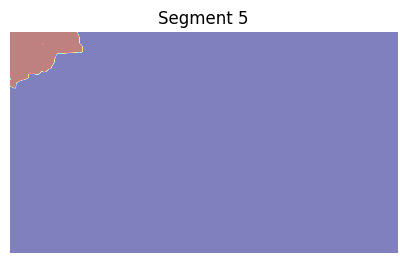

Segment 1: Best match -> car with score 0.2251
Segment 2: Best match -> house with score 0.2124
Segment 3: Best match -> car with score 0.2433
Segment 4: Best match -> car with score 0.2385
Segment 5: Best match -> car with score 0.2433
Segment 6: Best match -> dog with score 0.2311
Segment 7: Best match -> cat with score 0.2634
Segment 8: Best match -> man with score 0.2539
Segment 9: Best match -> man with score 0.2583
Segment 10: Best match -> car with score 0.2433
Segment 11: Best match -> car with score 0.2408
Segment 12: Best match -> car with score 0.2433
Segment 13: Best match -> car with score 0.2433
Segment 14: Best match -> car with score 0.2433
Segment 15: Best match -> dog with score 0.2598
Segment 16: Best match -> dog with score 0.2423
Segment 17: Best match -> car with score 0.2433
Segment 18: Best match -> car with score 0.2433
Segment 19: Best match -> dog with score 0.2534
Segment 20: Best match -> woman with score 0.2539
Segment 21: Best match -> tree with score 0.2

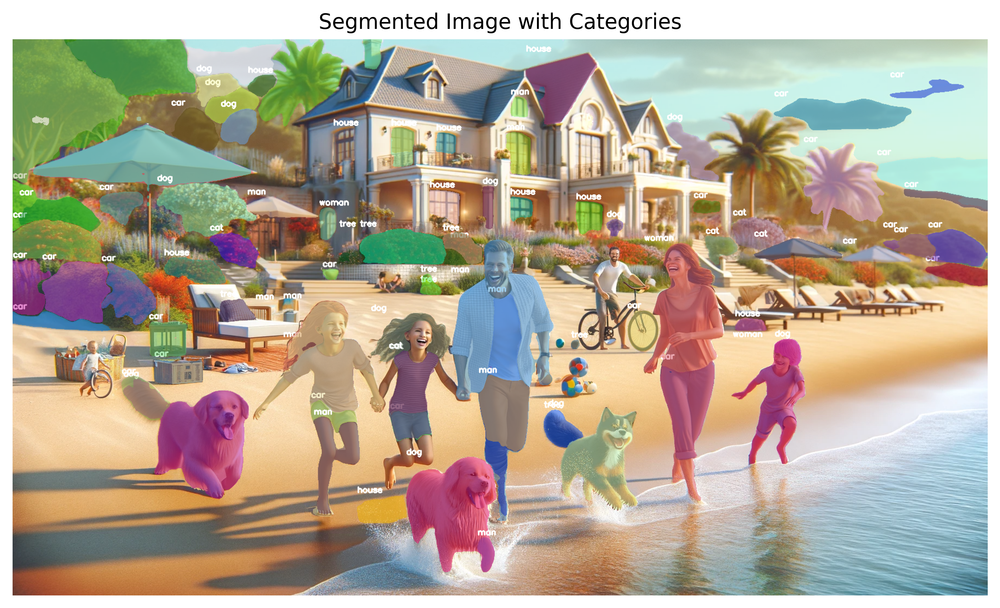

In [10]:

image2, masks2 = segementation("./images/family2.png")
segment_embeddings2 = extract_segment_embeddings(image2, masks2)
category2 = ["dog", "cat", "tree", "car", "man","woman","house"]  # Modify as needed

with torch.no_grad():
    text_inputs = clip.tokenize(category2).to(device)
    text_embeddings2 = clip_model.encode_text(text_inputs)
    text_embeddings2 /= text_embeddings2.norm(dim=-1, keepdim=True) 

matched_segments2 = match_segments_to_text(segment_embeddings2, text_embeddings2, category2)
overlayed_image = overlay_mask(image2, masks2, matched_segments2)

plt.figure(figsize=(10, 10),dpi=400)
plt.imshow(overlayed_image)
plt.axis("off")
plt.title("Segmented Image with Categories")
plt.show()

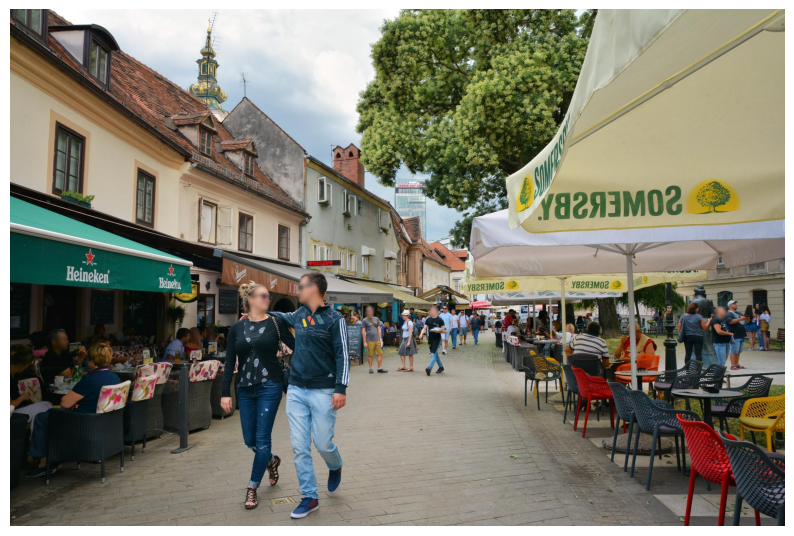

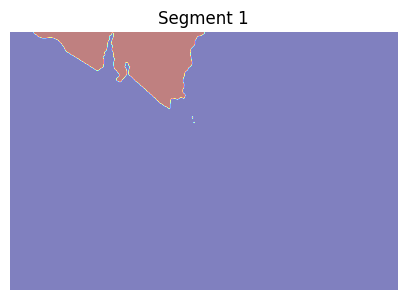

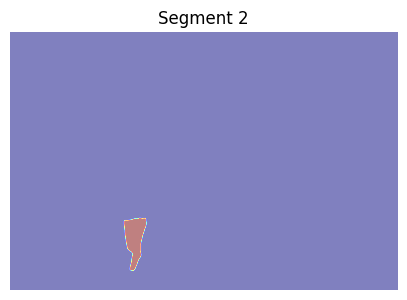

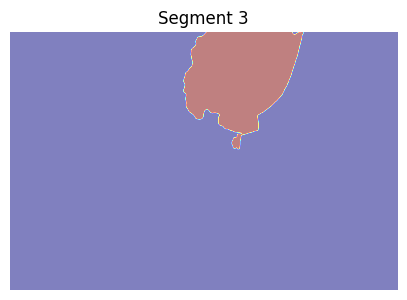

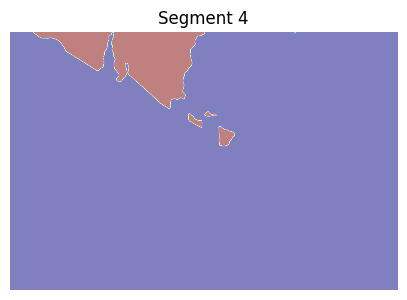

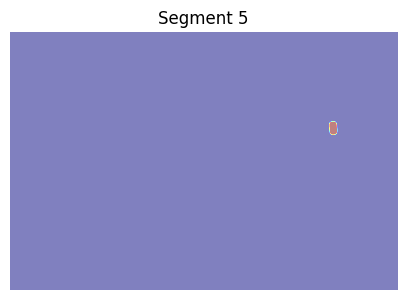

Segment 1: Best match -> person with score 0.2196
Segment 2: Best match -> chair with score 0.2489
Segment 3: Best match -> house with score 0.2279
Segment 4: Best match -> house with score 0.2261
Segment 5: Best match -> person with score 0.2452
Segment 6: Best match -> person with score 0.2590
Segment 7: Best match -> person with score 0.2563
Segment 8: Best match -> chair with score 0.2517
Segment 9: Best match -> chair with score 0.2527
Segment 10: Best match -> person with score 0.2563
Segment 11: Best match -> chair with score 0.2356
Segment 12: Best match -> chair with score 0.2340
Segment 13: Best match -> house with score 0.2491
Segment 14: Best match -> person with score 0.2563
Segment 15: Best match -> chair with score 0.2465
Segment 16: Best match -> chair with score 0.2443
Segment 17: Best match -> person with score 0.2563
Segment 18: Best match -> person with score 0.2498
Segment 19: Best match -> chair with score 0.2467
Segment 20: Best match -> person with score 0.2563


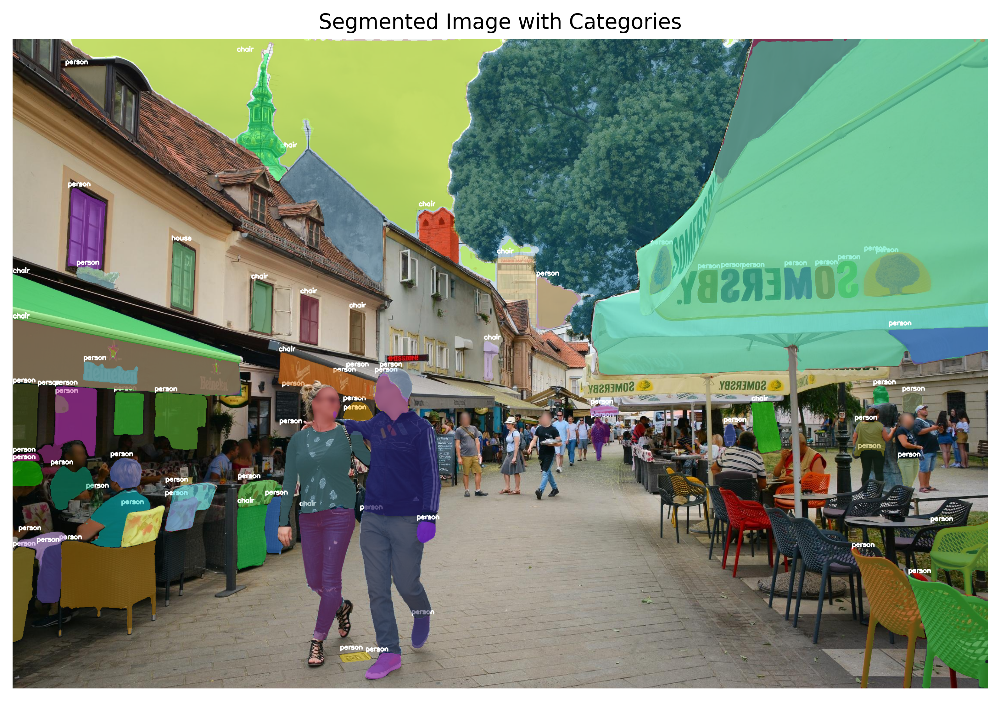

In [11]:
image2, masks2 = segementation("./images/sa_9.jpg")
segment_embeddings2 = extract_segment_embeddings(image2, masks2)
category2 = ["chair", "house", "person"]  # Modify as needed

with torch.no_grad():
    text_inputs = clip.tokenize(category2).to(device)
    text_embeddings2 = clip_model.encode_text(text_inputs)
    text_embeddings2 /= text_embeddings2.norm(dim=-1, keepdim=True) 

matched_segments2 = match_segments_to_text(segment_embeddings2, text_embeddings2, category2)
overlayed_image = overlay_mask(image2, masks2, matched_segments2)

plt.figure(figsize=(10, 10),dpi=400)
plt.imshow(overlayed_image)
plt.axis("off")
plt.title("Segmented Image with Categories")
plt.show()